# Importación de los datos

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import anderson
from sklearn.preprocessing import MultiLabelBinarizer
from ydata_profiling import ProfileReport
%matplotlib inline

In [3]:
shoppingBehavior = pd.read_csv('shoppingBehavior.csv')
shoppingBehavior.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually


In [4]:
shoppingTrends = pd.read_csv('shoppingTrends.csv')
shoppingTrends.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Payment Method,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Preferred Payment Method,Frequency of Purchases
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Credit Card,Express,Yes,Yes,14,Venmo,Fortnightly
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Bank Transfer,Express,Yes,Yes,2,Cash,Fortnightly
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Cash,Free Shipping,Yes,Yes,23,Credit Card,Weekly
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,PayPal,Next Day Air,Yes,Yes,49,PayPal,Weekly
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Cash,Free Shipping,Yes,Yes,31,PayPal,Annually


Debido a que ambos csv poseen la misma información se optará por utilizar el csv que posee la información más actualizada, este es el csv llamado shoppingBehavior (originalmente llamado shopping_behavior_updated.csv).

In [5]:
datos = pd.read_csv('shoppingBehavior.csv')
datos.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually


# Analizando la data

In [6]:
profile = ProfileReport(datos)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
datos.dtypes

Customer ID                 int64
Age                         int64
Gender                     object
Item Purchased             object
Category                   object
Purchase Amount (USD)       int64
Location                   object
Size                       object
Color                      object
Season                     object
Review Rating             float64
Subscription Status        object
Shipping Type              object
Discount Applied           object
Promo Code Used            object
Previous Purchases          int64
Payment Method             object
Frequency of Purchases     object
dtype: object

Luego de haber analizado los datos, se encontró que se cuenta con 5 variables de tipo numéricas, 10 de tipo categóricas y 3 de tipo booleanas, lo que nos da un total de 18 columnas. Así mismo no se encontraron datos faltantes, lo que indica que el csv está preprocesado para eliminar cualquier ocurrencia de este tipo, y ayuda al propósito, ya que no será necesario, ni eliminar ni "inventar" datos.

El csv cuenta con un total de 3900 entradas o filas. Una de las variables que no aporta información es Customer ID por lo que se eliminará en la parte de la limpieza de los datos. Así mismo hay que procesar todas las variables categóricas para que puedan ser utilizadas por el modelo de K-means, dichas variables son las siguientes:

- Gender: Male y Female
- Item Purchased: el artículo comprado
- Category: a qué categoría pertenece el artículo comprado
- Location: el lugar dónde se compró el artículo
- Size: el tamaño de la prenda comprada
- Color: el color de la prenda comprada
- Season: la temporada del año en la que se compró el artículo (Spring, fall, winter y summer)
- Shipping Type: el costo del envio o tipo de envio del artículo comprado
- Payment Method: el tipo de pago que utilizó el cliente para comprar el artículo
- Frequency of Purchase: la frecuencia con la que el cliente compra o se ve involucrado en actividades de compras

Con esto podemos observar que la cantidad de columnas luego de haber transformado la data, será bastante extensa por lo que hay que prestar atención a este acontecimiento.

# Limpieza de datos

In [8]:
datos = datos.drop("Customer ID", axis=1)
datos.head()

,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
0,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly
1,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly
2,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly
3,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly
4,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually


## Codificando la variables categóricas

In [9]:
genero = pd.get_dummies(datos["Gender"])
# Ya que género es una variable binaria, se puede eliminar una de las dos columnas
genero = genero.drop("Female", axis=1)
genero.head()

,Male
0,True
1,True
2,True
3,True
4,True


In [10]:
datos = pd.concat([datos, genero], axis=1)
datos = datos.drop("Gender", axis=1)
datos.head()

,Age,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Male
0,55,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly,True
1,19,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly,True
2,50,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly,True
3,21,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly,True
4,45,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually,True


In [11]:
variablesCategoricas = pd.get_dummies(datos[["Item Purchased", "Category", "Location", "Size", "Color", "Season", "Shipping Type", "Payment Method", "Frequency of Purchases"]])
variablesCategoricas.head()

,Item Purchased_Backpack,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,Item Purchased_Coat,Item Purchased_Dress,Item Purchased_Gloves,Item Purchased_Handbag,Item Purchased_Hat,Item Purchased_Hoodie,...,Payment Method_Debit Card,Payment Method_PayPal,Payment Method_Venmo,Frequency of Purchases_Annually,Frequency of Purchases_Bi-Weekly,Frequency of Purchases_Every 3 Months,Frequency of Purchases_Fortnightly,Frequency of Purchases_Monthly,Frequency of Purchases_Quarterly,Frequency of Purchases_Weekly
0,False,False,True,False,False,False,False,False,False,False,...,False,False,True,False,False,False,True,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
3,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,True
4,False,False,True,False,False,False,False,False,False,False,...,False,True,False,True,False,False,False,False,False,False


In [12]:
datos = datos.drop(["Item Purchased", "Category", "Location", "Size", "Color", "Season", "Shipping Type", "Payment Method", "Frequency of Purchases"], axis=1)
datos = pd.concat([datos, variablesCategoricas], axis=1)
datos.head()

,Age,Purchase Amount (USD),Review Rating,Subscription Status,Discount Applied,Promo Code Used,Previous Purchases,Male,Item Purchased_Backpack,Item Purchased_Belt,...,Payment Method_Debit Card,Payment Method_PayPal,Payment Method_Venmo,Frequency of Purchases_Annually,Frequency of Purchases_Bi-Weekly,Frequency of Purchases_Every 3 Months,Frequency of Purchases_Fortnightly,Frequency of Purchases_Monthly,Frequency of Purchases_Quarterly,Frequency of Purchases_Weekly
0,55,53,3.1,Yes,Yes,Yes,14,True,False,False,...,False,False,True,False,False,False,True,False,False,False
1,19,64,3.1,Yes,Yes,Yes,2,True,False,False,...,False,False,False,False,False,False,True,False,False,False
2,50,73,3.1,Yes,Yes,Yes,23,True,False,False,...,False,False,False,False,False,False,False,False,False,True
3,21,90,3.5,Yes,Yes,Yes,49,True,False,False,...,False,True,False,False,False,False,False,False,False,True
4,45,49,2.7,Yes,Yes,Yes,31,True,False,False,...,False,True,False,True,False,False,False,False,False,False


In [13]:
profile = ProfileReport(datos)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
datosNumericos = datos.select_dtypes(include=[np.number])
datosNumericos.head()

,Age,Purchase Amount (USD),Review Rating,Previous Purchases
0,55,53,3.1,14
1,19,64,3.1,2
2,50,73,3.1,23
3,21,90,3.5,49
4,45,49,2.7,31


## Normalización de datos
Se normalizarán únicamente los datos que son de tipo numérico y se normalizarán en un rango de 0 a 1, para que cuadren con los demás datos que se cambiaron a booleanos.

In [15]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
datosEscala = pd.DataFrame(scaler.fit_transform(datosNumericos), columns=datosNumericos.columns)
datosEscala.head()

,Age,Purchase Amount (USD),Review Rating,Previous Purchases
0,0.711538,0.4125,0.24,0.265306
1,0.019231,0.5500,0.24,0.020408
2,0.615385,0.6625,0.24,0.448980
3,0.057692,0.8750,0.40,0.979592
4,0.519231,0.3625,0.08,0.612245


In [16]:
datosLimpios = datos.drop(datosNumericos.columns, axis=1)
datosLimpios = pd.concat([datosLimpios, datosEscala], axis=1)
datosLimpios.head()

,Subscription Status,Discount Applied,Promo Code Used,Male,Item Purchased_Backpack,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,Item Purchased_Coat,Item Purchased_Dress,...,Frequency of Purchases_Bi-Weekly,Frequency of Purchases_Every 3 Months,Frequency of Purchases_Fortnightly,Frequency of Purchases_Monthly,Frequency of Purchases_Quarterly,Frequency of Purchases_Weekly,Age,Purchase Amount (USD),Review Rating,Previous Purchases
0,Yes,Yes,Yes,True,False,False,True,False,False,False,...,False,False,True,False,False,False,0.711538,0.4125,0.24,0.265306
1,Yes,Yes,Yes,True,False,False,False,False,False,False,...,False,False,True,False,False,False,0.019231,0.5500,0.24,0.020408
2,Yes,Yes,Yes,True,False,False,False,False,False,False,...,False,False,False,False,False,True,0.615385,0.6625,0.24,0.448980
3,Yes,Yes,Yes,True,False,False,False,False,False,False,...,False,False,False,False,False,True,0.057692,0.8750,0.40,0.979592
4,Yes,Yes,Yes,True,False,False,True,False,False,False,...,False,False,False,False,False,False,0.519231,0.3625,0.08,0.612245


In [17]:
datosLimpios = datosLimpios.replace({'Yes': 1, 'No': 0})
datosLimpios = datosLimpios.replace({True: 1, False: 0})
datosLimpios.head()

,Subscription Status,Discount Applied,Promo Code Used,Male,Item Purchased_Backpack,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,Item Purchased_Coat,Item Purchased_Dress,...,Frequency of Purchases_Bi-Weekly,Frequency of Purchases_Every 3 Months,Frequency of Purchases_Fortnightly,Frequency of Purchases_Monthly,Frequency of Purchases_Quarterly,Frequency of Purchases_Weekly,Age,Purchase Amount (USD),Review Rating,Previous Purchases
0,1,1,1,1,0,0,1,0,0,0,...,0,0,1,0,0,0,0.711538,0.4125,0.24,0.265306
1,1,1,1,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0.019231,0.5500,0.24,0.020408
2,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0.615385,0.6625,0.24,0.448980
3,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0.057692,0.8750,0.40,0.979592
4,1,1,1,1,0,0,1,0,0,0,...,0,0,0,0,0,0,0.519231,0.3625,0.08,0.612245


In [18]:
datosLimpios = datosLimpios.astype(float)
for columna in datosLimpios.dtypes:
    print(columna)

float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64


In [19]:
profile = ProfileReport(datosLimpios)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Clustering K-means

## Primer vistazo

In [20]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3)
kmeans.fit(datosLimpios)

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=3)

In [21]:
etiquetas = kmeans.labels_
print(etiquetas)

[1 1 1 ... 2 2 2]


In [22]:
centros = kmeans.cluster_centers_
print(centros)

[[-1.05471187e-15 -1.72084569e-15 -1.72084569e-15  4.47316103e-01
  -1.52655666e-16 -1.38777878e-17  1.12326044e-01  9.02056208e-17
  -1.38777878e-17  9.04572565e-02  7.63278329e-17 -1.73472348e-16
   7.63278329e-17  8.25049702e-02 -1.73472348e-16  6.66003976e-02
  -6.93889390e-18  8.94632207e-02  1.11022302e-16 -8.32667268e-17
   9.74155070e-02  1.04083409e-16  8.84691849e-02  9.64214712e-02
   5.55111512e-17  1.06361829e-01 -1.38777878e-17  8.44930417e-02
   8.54870775e-02  2.77555756e-16  1.00000000e+00 -1.38777878e-16
  -2.91433544e-16  1.98807157e-02  1.88866799e-02  2.38568588e-02
   1.88866799e-02  2.78330020e-02  1.98807157e-02  2.38568588e-02
   2.48508946e-02  1.49105368e-02  2.48508946e-02  1.09343936e-02
   2.88270378e-02  2.98210736e-02  1.68986083e-02  8.94632207e-03
   1.78926441e-02  1.88866799e-02  2.48508946e-02  1.98807157e-02
   1.78926441e-02  1.59045726e-02  2.08747515e-02  2.18687873e-02
   1.39165010e-02  1.98807157e-02  2.98210736e-02  1.88866799e-02
   2.18687

In [23]:
matrizCorrelacion = datosLimpios.corr()
print(matrizCorrelacion)

                               Subscription Status  Discount Applied  \
Subscription Status                       1.000000          0.700202   
Discount Applied                          0.700202          1.000000   
Promo Code Used                           0.700202          1.000000   
Male                                      0.417197          0.595823   
Item Purchased_Backpack                   0.013491          0.006917   
...                                            ...               ...   
Frequency of Purchases_Weekly             0.019195          0.003347   
Age                                       0.006492          0.004366   
Purchase Amount (USD)                    -0.006996         -0.017798   
Review Rating                            -0.006368         -0.012486   
Previous Purchases                        0.030859          0.023537   

                               Promo Code Used      Male  \
Subscription Status                   0.700202  0.417197   
Discount Applie

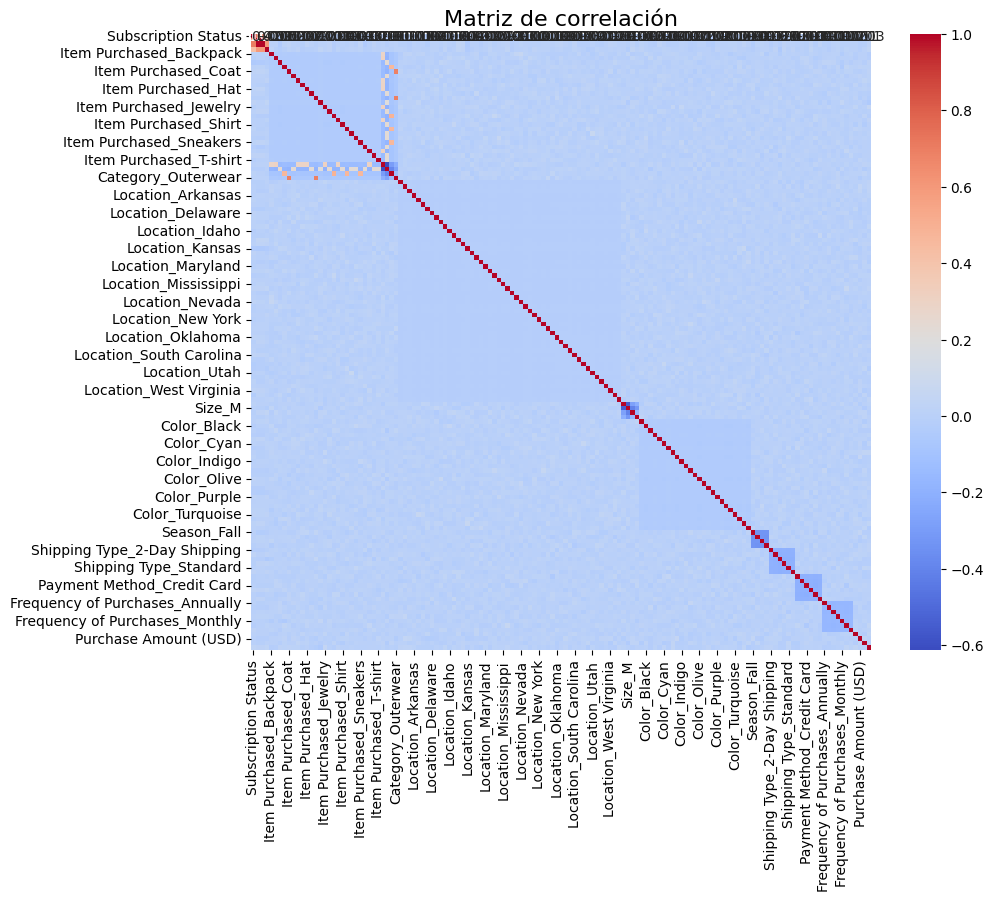

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

# Aumentar el tamaño de la gráfica
plt.figure(figsize=(10, 8))

# Crear la gráfica de calor con un tamaño de fuente mayor para las anotaciones
sns.heatmap(matrizCorrelacion, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})

plt.title('Matriz de correlación', fontsize=16)
plt.show()

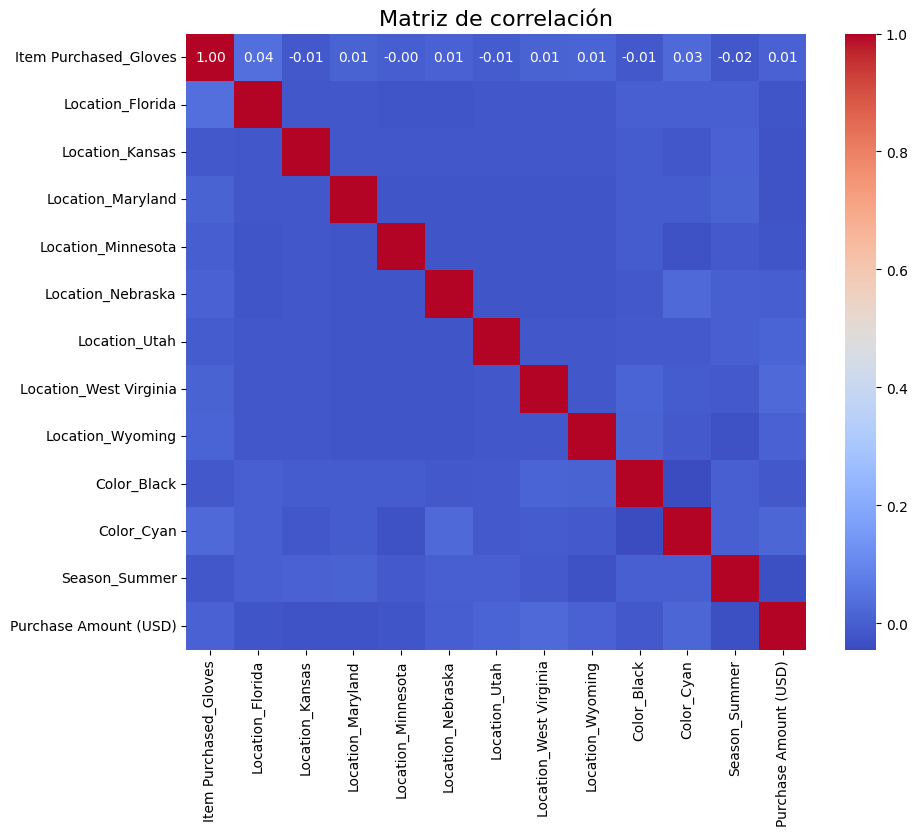

In [25]:
mask = np.abs(matrizCorrelacion) > 0.0005

column_mask = np.all(mask, axis=0)

row_mask = np.all(mask, axis=1)

matrizCorrelacion_filtrada = matrizCorrelacion.loc[row_mask, column_mask]

if matrizCorrelacion_filtrada.empty:
    print("No hay filas ni columnas con una correlación fuerte.")
else:
    plt.figure(figsize=(10, 8))
    sns.heatmap(matrizCorrelacion_filtrada, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})

    plt.title('Matriz de correlación', fontsize=16)
    plt.show()

In [26]:
correlation_series = matrizCorrelacion.unstack()

correlation_series = correlation_series[correlation_series.index.get_level_values(0) != correlation_series.index.get_level_values(1)]

sorted_correlations = correlation_series.sort_values(key=abs, ascending=False)

for index, value in sorted_correlations.items():
        print(index, value)


('Promo Code Used', 'Discount Applied') 1.0
('Discount Applied', 'Promo Code Used') 1.0
('Subscription Status', 'Discount Applied') 0.7002024919882511
('Subscription Status', 'Promo Code Used') 0.7002024919882511
('Discount Applied', 'Subscription Status') 0.7002024919882511
('Promo Code Used', 'Subscription Status') 0.7002024919882511
('Item Purchased_Jacket', 'Category_Outerwear') 0.6938386737379816
('Category_Outerwear', 'Item Purchased_Jacket') 0.6938386737379816
('Category_Outerwear', 'Item Purchased_Coat') 0.6893844060542473
('Item Purchased_Coat', 'Category_Outerwear') 0.6893844060542473
('Category_Clothing', 'Category_Accessories') -0.611845364095063
('Category_Accessories', 'Category_Clothing') -0.611845364095063
('Male', 'Discount Applied') 0.5958230945160812
('Male', 'Promo Code Used') 0.5958230945160812
('Discount Applied', 'Male') 0.5958230945160812
('Promo Code Used', 'Male') 0.5958230945160812
('Size_M', 'Size_L') -0.5501047109652422
('Size_L', 'Size_M') -0.5501047109652

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


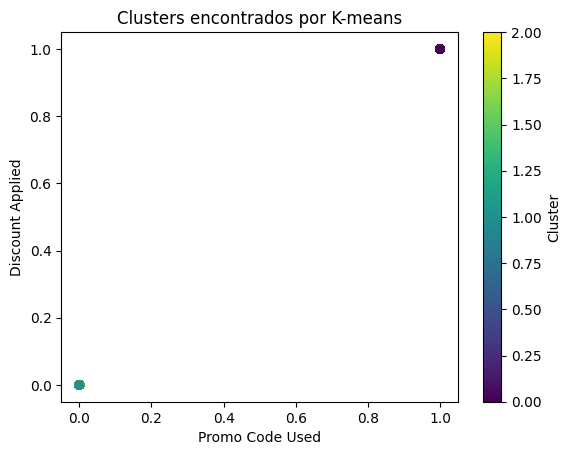

In [27]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

caracteristica1 = 'Promo Code Used'  
caracteristica2 = 'Discount Applied'

x = datosLimpios[caracteristica1]
y = datosLimpios[caracteristica2]

kmeans = KMeans(n_clusters=3)
kmeans.fit(datosLimpios)
clusters = kmeans.predict(datosLimpios)

plt.scatter(x, y, c=clusters, cmap='viridis')
plt.title('Clusters encontrados por K-means')
plt.xlabel(caracteristica1)
plt.ylabel(caracteristica2)
plt.colorbar(label='Cluster')
plt.show()


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


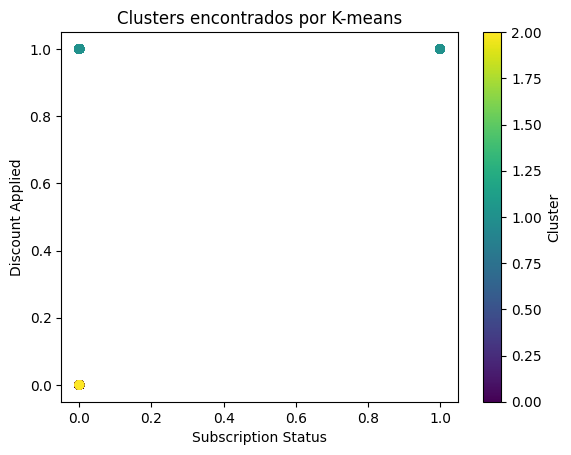

In [28]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

caracteristica1 = 'Subscription Status'  
caracteristica2 = 'Discount Applied'

x = datosLimpios[caracteristica1]
y = datosLimpios[caracteristica2]

kmeans = KMeans(n_clusters=3)
kmeans.fit(datosLimpios)
clusters = kmeans.predict(datosLimpios)

plt.scatter(x, y, c=clusters, cmap='viridis')
plt.title('Clusters encontrados por K-means')
plt.xlabel(caracteristica1)
plt.ylabel(caracteristica2)
plt.colorbar(label='Cluster')
plt.show()


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


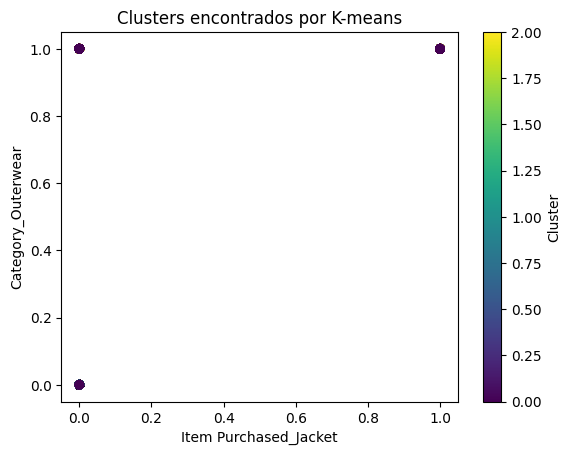

In [29]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

caracteristica1 = 'Item Purchased_Jacket'  
caracteristica2 = 'Category_Outerwear'

x = datosLimpios[caracteristica1]
y = datosLimpios[caracteristica2]

kmeans = KMeans(n_clusters=3)
kmeans.fit(datosLimpios)
clusters = kmeans.predict(datosLimpios)

plt.scatter(x, y, c=clusters, cmap='viridis')
plt.title('Clusters encontrados por K-means')
plt.xlabel(caracteristica1)
plt.ylabel(caracteristica2)
plt.colorbar(label='Cluster')
plt.show()


## Método del codo

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  s

Text(0.5, 1.0, 'K optimas con el metodo del codo')

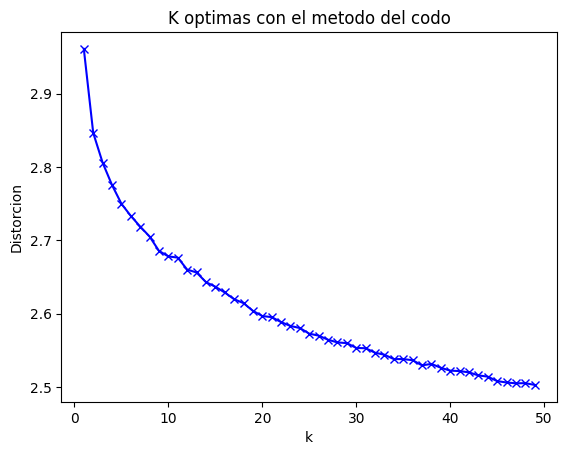

In [30]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist

distortions = []
K = range(1,50)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(datosLimpios)
    kmeanModel.fit(datosLimpios)
    distortions.append(sum(np.min(cdist(datosLimpios, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / datosLimpios.shape[0])

plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distorcion')
plt.title('K optimas con el metodo del codo')


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  s

El mejor valor de k es:  2


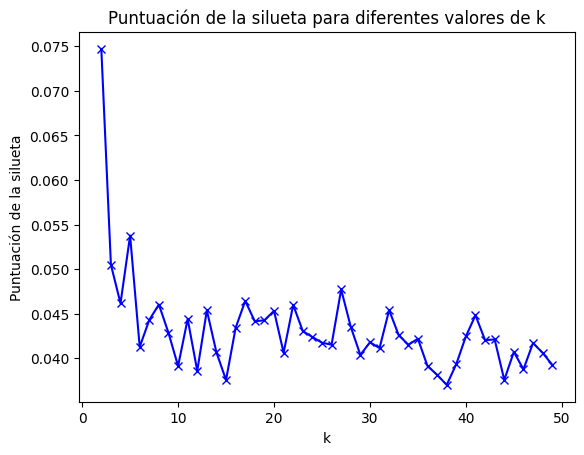

In [31]:
from sklearn.metrics import silhouette_score

silhouette_scores = [] 

K = range(2,50) 

mejor_k = 0
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(datosLimpios)
    labels = kmeanModel.labels_
    silhouette_scores.append(silhouette_score(datosLimpios, labels, metric = 'euclidean'))
    if silhouette_scores[-1] == max(silhouette_scores):
        mejor_k = k

print("El mejor valor de k es: ", mejor_k)
plt.plot(K, silhouette_scores, 'bx-')
plt.xlabel('k')
plt.ylabel('Puntuación de la silueta')
plt.title('Puntuación de la silueta para diferentes valores de k')
plt.show()

Con esto podemos definir que el mejor número para K es de 2, ya que ofrece un coste computacional bajo, y es el que más puntaje posee en el método de la silueta, es decir el que mejor clasifica los datos.

## Utilizando la cantidad óptima de clusters (2)

In [32]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(datosLimpios)

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=2)

In [33]:
clusters_identificados = kmeans.fit_predict(datosLimpios)
clusters_identificados

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


array([1, 1, 1, ..., 0, 0, 0])

# Analizando los clusters

In [37]:
datosLimpios['cluster'] = kmeans.labels_
caracteristicas_promedio = datosLimpios.groupby('cluster').mean()
caracteristicas_promedio.head()

,Subscription Status,Discount Applied,Promo Code Used,Male,Item Purchased_Backpack,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,Item Purchased_Coat,Item Purchased_Dress,...,Frequency of Purchases_Bi-Weekly,Frequency of Purchases_Every 3 Months,Frequency of Purchases_Fortnightly,Frequency of Purchases_Monthly,Frequency of Purchases_Quarterly,Frequency of Purchases_Weekly,Age,Purchase Amount (USD),Review Rating,Previous Purchases
cluster,,,,,,,,,,,,,,,,,,,,,
0,0.000000,0.0,0.0,0.438596,0.035538,0.040036,0.050832,0.034638,0.036887,0.040936,...,0.144399,0.146649,0.134503,0.142150,0.144849,0.137202,0.500208,0.501631,0.503086,0.490943
1,0.627907,1.0,1.0,1.000000,0.038163,0.042934,0.034586,0.039952,0.047108,0.044723,...,0.134764,0.153846,0.144902,0.141324,0.143709,0.139535,0.502787,0.490988,0.495862,0.504959


In [39]:
for columna in caracteristicas_promedio.columns:
    print(columna)
    print(caracteristicas_promedio[columna])
    print()

Subscription Status
cluster
0    0.000000
1    0.627907
Name: Subscription Status, dtype: float64

Discount Applied
cluster
0    0.0
1    1.0
Name: Discount Applied, dtype: float64

Promo Code Used
cluster
0    0.0
1    1.0
Name: Promo Code Used, dtype: float64

Male
cluster
0    0.438596
1    1.000000
Name: Male, dtype: float64

Item Purchased_Backpack
cluster
0    0.035538
1    0.038163
Name: Item Purchased_Backpack, dtype: float64

Item Purchased_Belt
cluster
0    0.040036
1    0.042934
Name: Item Purchased_Belt, dtype: float64

Item Purchased_Blouse
cluster
0    0.050832
1    0.034586
Name: Item Purchased_Blouse, dtype: float64

Item Purchased_Boots
cluster
0    0.034638
1    0.039952
Name: Item Purchased_Boots, dtype: float64

Item Purchased_Coat
cluster
0    0.036887
1    0.047108
Name: Item Purchased_Coat, dtype: float64

Item Purchased_Dress
cluster
0    0.040936
1    0.044723
Name: Item Purchased_Dress, dtype: float64

Item Purchased_Gloves
cluster
0    0.035987
1    0.035778


## PCA

In [41]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
componentes_principales = pca.fit_transform(datosLimpios)
kmeans = KMeans(n_clusters=2)
kmeans.fit(componentes_principales)
etiquetas_clusters = kmeans.labels_

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


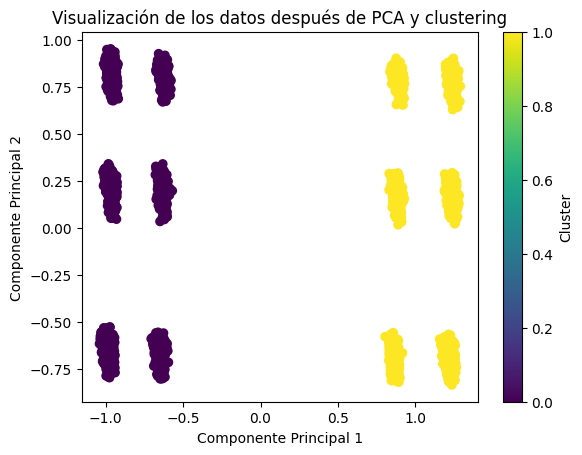

In [42]:
import matplotlib.pyplot as plt

plt.scatter(componentes_principales[:, 0], componentes_principales[:, 1], c=etiquetas_clusters, cmap='viridis')
plt.title('Visualización de los datos después de PCA y clustering')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.colorbar(label='Cluster')
plt.show()